In [ ]:
# %%

import numpy as np
from astropy.table import Table, join
import matplotlib.pyplot as plt
import umap
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.ndimage import gaussian_filter1d as smooth

PROVABGS_PATH = "C:\datasets_astroclip\BGS_ANY_full.provabgs.sv3.v0.hdf5"


print("imports done")

In [ ]:
# %%

# Load the embeddings
print("loading embeddings")
emb = np.load("data/embeddings-main.npz")
source_images = emb["images"]
im_embeddings = emb["im_embeddings"]
spectra = emb["spectra"]
redshifts = emb["redshifts"]
source_spec = emb["source_spec"]
targetid = emb["targetid"]
print("embeddings loaded")

In [ ]:
# %%

# Create a UMAP of the spectra embeddings
umap_sp = umap.UMAP()
emb_map_sp = umap_sp.fit_transform(provabgs["spectrum_embedding"])

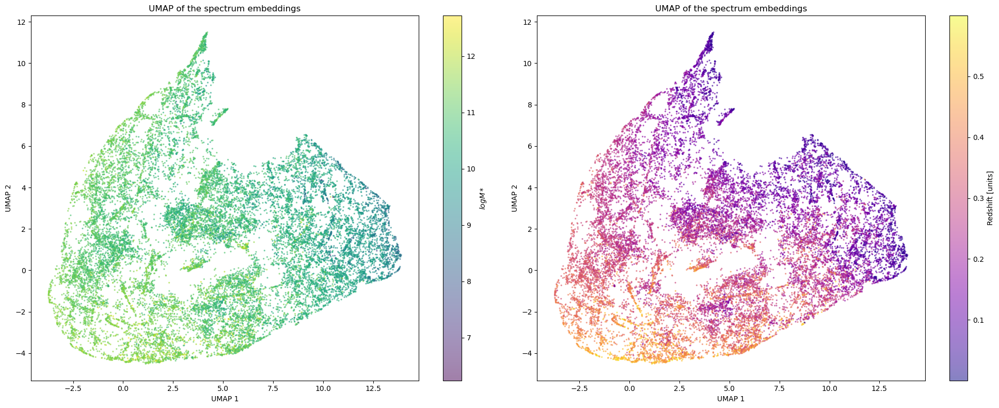

In [ ]:
# %%

# plot the umap
plt.figure(figsize=(20, 8))

# Plot the UMAP of spectrum embeddings
plt.subplot(1, 2, 1)
plt.scatter(
    emb_map_sp[:, 0],
    emb_map_sp[:, 1],
    c=provabgs["PROVABGS_LOGMSTAR_BF"],
    cmap="viridis",
    s=2,
    alpha=0.5,
)
plt.colorbar(label=r"$logM*$")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("UMAP of the spectrum embeddings")

# Plot the UMAP of spectrum embeddings with redshift as the color
plt.subplot(1, 2, 2)
plt.scatter(
    emb_map_sp[:, 0],
    emb_map_sp[:, 1],
    c=provabgs["Z_HP"],
    cmap="plasma",
    s=2,
    alpha=0.5,
)
plt.colorbar(label="Redshift [units]")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("UMAP of the spectrum embeddings")

plt.tight_layout()
plt.show()

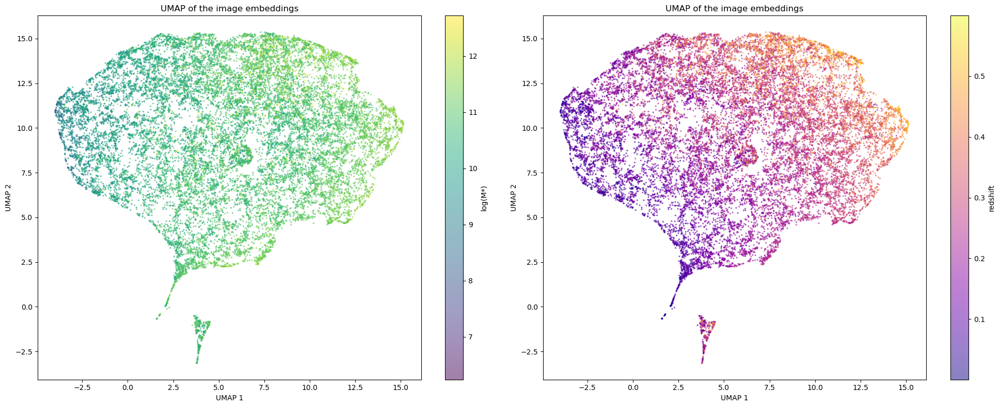

In [ ]:
# %% Umap of the image embeddings

umap_im = umap.UMAP()
emb_map_im = umap_im.fit_transform(provabgs["image_embedding"])

# plot the umap
plt.figure(figsize=(20, 8))

# Plot the UMAP of image embeddings with log(M*) as the color
plt.subplot(1, 2, 1)
plt.scatter(
    emb_map_im[:, 0],
    emb_map_im[:, 1],
    c=provabgs["PROVABGS_LOGMSTAR_BF"],
    cmap="viridis",
    s=2,
    alpha=0.5,
)
plt.colorbar(label="log(M*)")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("UMAP of the image embeddings")

# Plot the UMAP of image embeddings with redshift as the color
plt.subplot(1, 2, 2)
plt.scatter(
    emb_map_im[:, 0],
    emb_map_im[:, 1],
    c=provabgs["Z_HP"],
    cmap="plasma",
    s=2,
    alpha=0.5,
)
plt.colorbar(label="redshift")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("UMAP of the image embeddings")

plt.tight_layout()
plt.show()

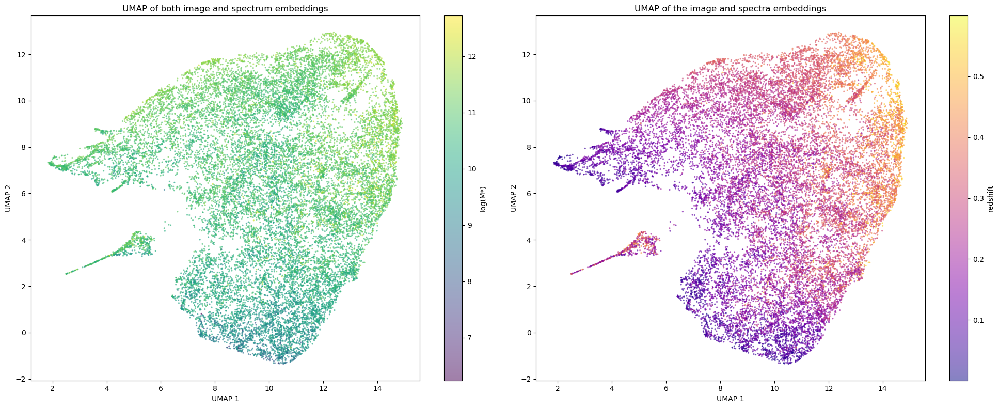

In [ ]:
# %% Umap of both image and spectra embeddings

umap_both = umap.UMAP()
emb_map_both = umap_both.fit_transform(
    np.concatenate(
        [provabgs["image_embedding"], provabgs["spectrum_embedding"]], axis=1
    )
)
# plot the umap
plt.figure(figsize=(20, 8))

# Plot the UMAP of the image and spectra embeddings with log(M*) as the color
plt.subplot(1, 2, 1)
plt.scatter(
    emb_map_both[:, 0],
    emb_map_both[:, 1],
    c=provabgs["PROVABGS_LOGMSTAR_BF"],
    cmap="viridis",
    s=2,
    alpha=0.5,
)
plt.colorbar(label="log(M*)")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("UMAP of both image and spectrum embeddings")

# Plot the UMAP of the image and spectra embeddings with redshift as the color
plt.subplot(1, 2, 2)
plt.scatter(
    emb_map_both[:, 0],
    emb_map_both[:, 1],
    c=provabgs["Z_HP"],
    cmap="plasma",
    s=2,
    alpha=0.5,
)
plt.colorbar(label="redshift")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("UMAP of the image and spectra embeddings")

plt.tight_layout()
plt.show()

For n_clusters = 2, the average silhouette_score is 0.6287250518798828
For n_clusters = 3, the average silhouette_score is 0.26459628343582153
For n_clusters = 4, the average silhouette_score is 0.21726645529270172
For n_clusters = 5, the average silhouette_score is 0.22443227469921112
For n_clusters = 6, the average silhouette_score is 0.2364223450422287
For n_clusters = 7, the average silhouette_score is 0.22946590185165405
For n_clusters = 8, the average silhouette_score is 0.23430415987968445
For n_clusters = 9, the average silhouette_score is 0.22971142828464508
For n_clusters = 10, the average silhouette_score is 0.22126024961471558


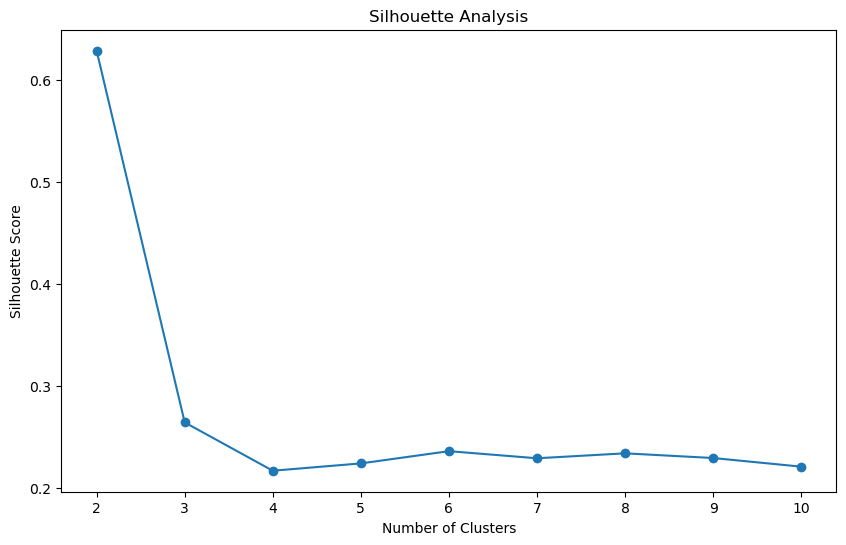

In [ ]:
# %% Silhouette analysis


def silhouette_analysis(embeddings, max_clusters):
    silhouette_scores = []
    for n_clusters in range(2, max_clusters + 1):
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        cluster_labels = kmeans.fit_predict(embeddings)
        silhouette_avg = silhouette_score(embeddings, cluster_labels)
        silhouette_scores.append(silhouette_avg)
        print(
            f"For n_clusters = {n_clusters}, the average silhouette_score is {silhouette_avg}"
        )

    plt.figure(figsize=(10, 6))
    plt.plot(range(2, max_clusters + 1), silhouette_scores, marker="o")
    plt.title("Silhouette Analysis")
    plt.xlabel("Number of Clusters")
    plt.ylabel("Silhouette Score")
    plt.show()

    return silhouette_scores


max_clusters = 10
silhouette_scores = silhouette_analysis(provabgs["spectrum_embedding"], max_clusters)

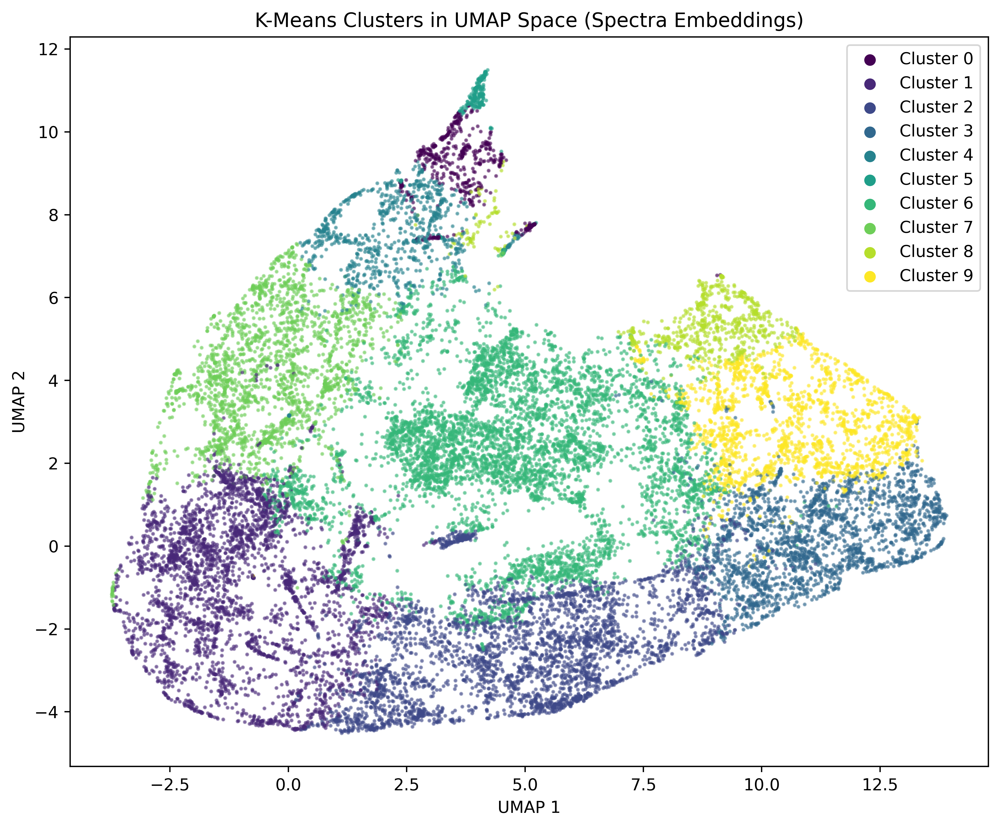

In [ ]:
# %% Cluster the spectra embeddings using KMeans

num_clusters = 10
kmeans = KMeans(n_clusters=num_clusters, random_state=25101999)
kmeans_clusters_sp = kmeans.fit_predict(provabgs["spectrum_embedding"])

# # Add the cluster labels to table
provabgs["kmeans_cluster_sp"] = kmeans_clusters_sp

plt.figure(figsize=(10, 8), dpi=500)
plt.scatter(
    emb_map_sp[:, 0],
    emb_map_sp[:, 1],
    c=provabgs["kmeans_cluster_sp"],
    cmap="viridis",
    s=2,
    alpha=0.5,
)

# Extract unique labels
unique_labels = np.unique(provabgs["kmeans_cluster_sp"])

# Correct way to map cluster labels to colors using normalization
norm = plt.Normalize(vmin=min(unique_labels), vmax=max(unique_labels))
unique_colors = [plt.cm.viridis(norm(label)) for label in unique_labels]

for i, color in zip(unique_labels, unique_colors):
    plt.scatter([], [], color=color, label=f"Cluster {i}")


plt.legend()
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("K-Means Clusters in UMAP Space (Spectra Embeddings)")
plt.show()

In [ ]:
# %%

# Get the silhouette score for the clustering
silhouette_score(provabgs["spectrum_embedding"], kmeans_clusters_sp)

0.21446966

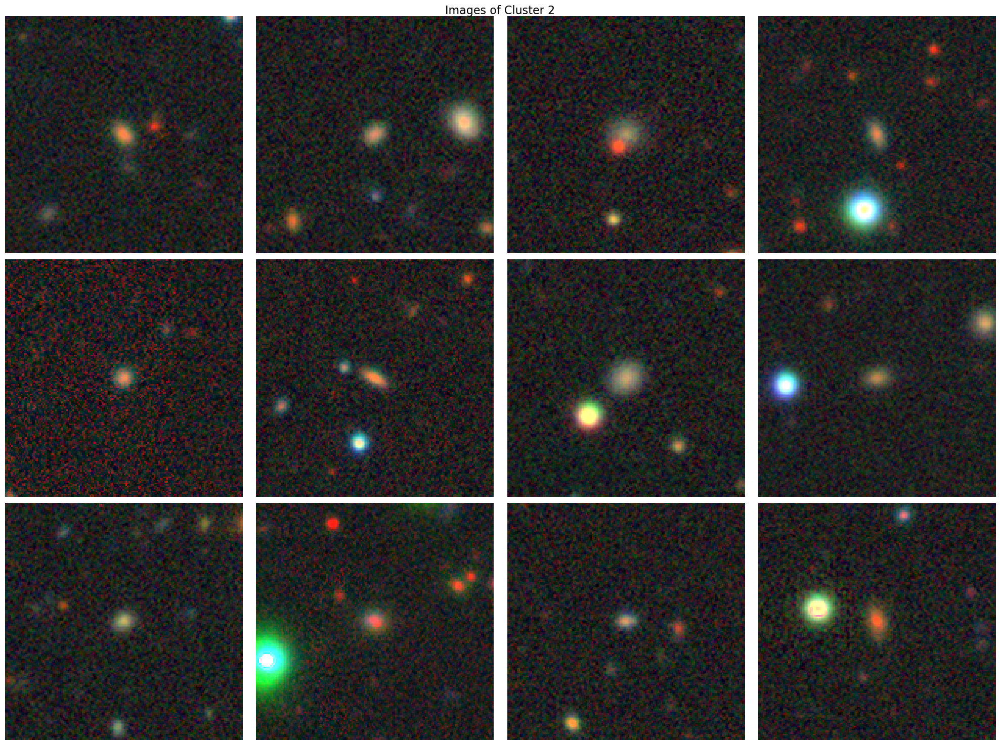

In [ ]:
# %%


def plot_cluster_spectra(cluster_label, kmeans_labels, provabgs, num_spectra=5):
    """
    Plots the spectra of the selected cluster entries.

    Parameters:
    - cluster_label: The label of the cluster to extract.
    - kmeans_labels: The array of cluster labels from KMeans.
    - provabgs: The astropy table containing the data.
    - num_spectra: The number of spectra to plot.
    """
    cluster_indices = np.where(kmeans_labels == cluster_label)[0]

    # Ensure we don't try to plot more spectra than we have
    num_spectra = min(num_spectra, len(cluster_indices))
    selected_indices = np.random.choice(cluster_indices, num_spectra, replace=False)

    plt.figure(figsize=(4, 4))

    l = np.linspace(3586.7408577, 10372.89543574, source_spec.shape[1])

    for idx in selected_indices:
        entry = provabgs[idx]
        spectrum = entry["source_spec"][:, 0]

        # Plot the spectrum
        plt.plot(l, smooth(spectrum, 6), alpha=0.6)

    plt.xlabel(r"$\lambda [\AA]$")
    plt.ylabel("Flux")
    plt.title(f"Spectra of Cluster {cluster_label}")
    plt.legend()
    plt.tight_layout()
    plt.show()


def plot_cluster_images(cluster_label, kmeans_labels, provabgs, num_images=8):
    """
    Plots the images of the selected cluster entries in rows of 4.

    Parameters:
    - cluster_label: The label of the cluster to extract.
    - kmeans_labels: The array of cluster labels from KMeans.
    - provabgs: The astropy table containing the data.
    - num_images: The number of images to plot.
    """
    cluster_indices = np.where(kmeans_labels == cluster_label)[0]

    # Ensure we don't try to plot more images than we have
    num_images = min(num_images, len(cluster_indices))
    selected_indices = np.random.choice(cluster_indices, num_images, replace=False)

    # Determine the number of rows needed to display 4 images per row
    num_rows = (num_images + 3) // 4  #

    fig, axes = plt.subplots(num_rows, 4, figsize=(20, num_rows * 5))

    for i, idx in enumerate(selected_indices):
        entry = provabgs[idx]
        image = entry["source_image"]

        row = i // 4
        col = i % 4

        axes[row, col].imshow(image, cmap="gray")
        axes[row, col].axis("off")

    # Hide any remaining empty subplots
    for j in range(i + 1, num_rows * 4):
        row = j // 4
        col = j % 4
        axes[row, col].axis("off")

    fig.suptitle(f"Images of Cluster {cluster_label}", fontsize=16)
    plt.tight_layout()
    plt.show()


cluster_label = 2  # cluster to inspect
plot_cluster_images(cluster_label, kmeans_clusters_sp, provabgs, num_images=12)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


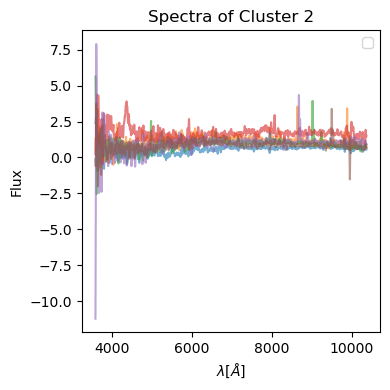

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


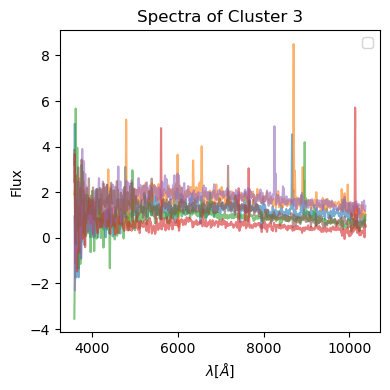

In [ ]:
# %%

cluster_label = 2  # Specify the cluster you want to inspect
plot_cluster_spectra(cluster_label, kmeans_clusters_sp, provabgs, num_spectra=6)
plot_cluster_spectra(3, kmeans_clusters_sp, provabgs, num_spectra=6)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


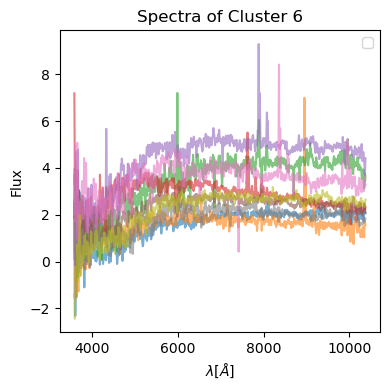

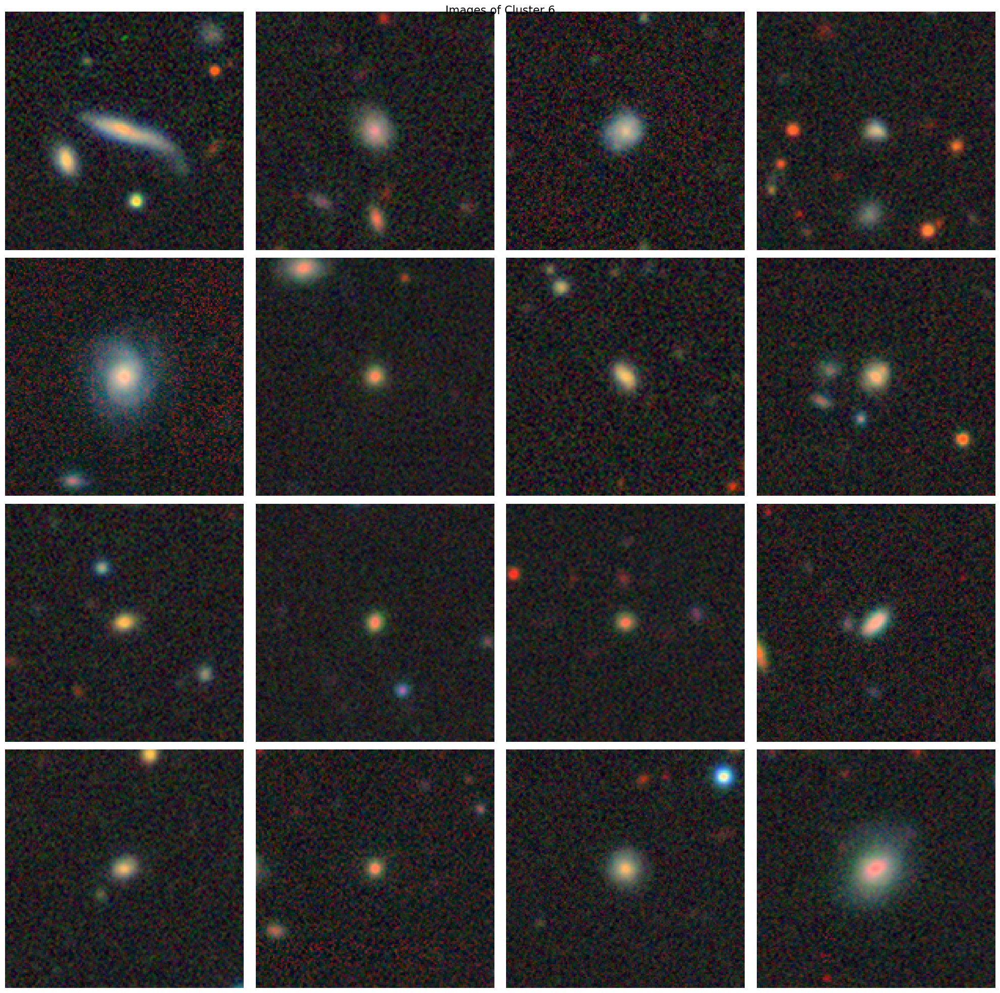

In [ ]:
# %%

cluster_num = 6
plot_cluster_spectra(cluster_num, kmeans_clusters_sp, provabgs, num_spectra=9)
plot_cluster_images(cluster_num, kmeans_clusters_sp, provabgs, num_images=16)

For n_clusters = 2, the average silhouette_score is 0.9832625389099121
For n_clusters = 3, the average silhouette_score is 0.9779968857765198
For n_clusters = 4, the average silhouette_score is 0.3590652048587799
For n_clusters = 5, the average silhouette_score is 0.36721643805503845


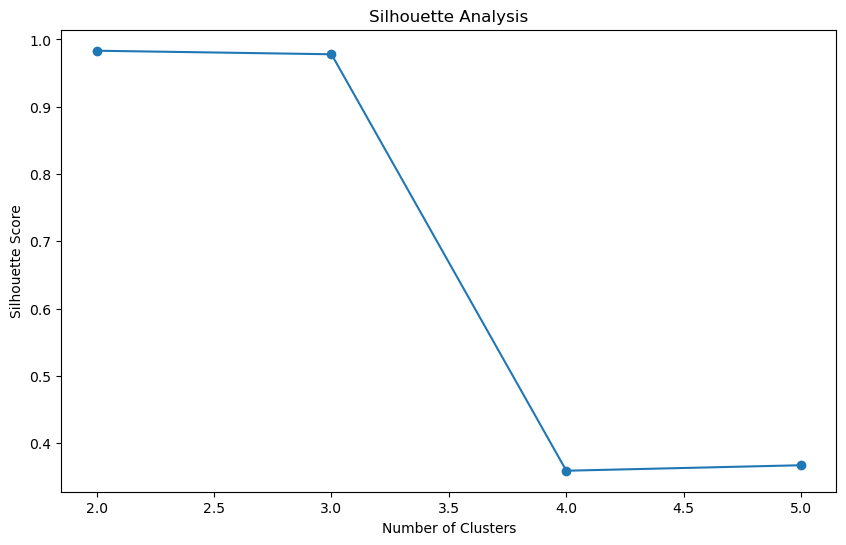

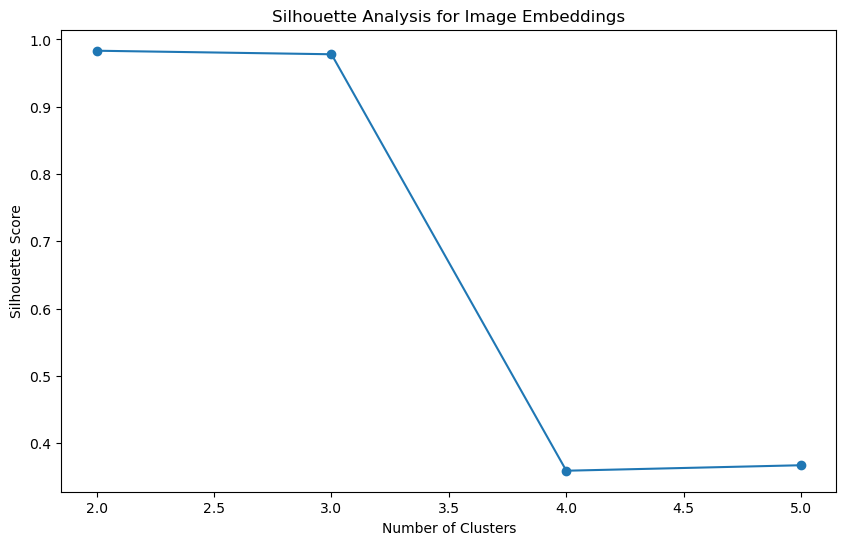

In [ ]:
# %%

max_clusters = 5
silhouette_scores = silhouette_analysis(provabgs["image_embedding"], max_clusters)

# plot the silhouette scores
plt.figure(figsize=(10, 6))
plt.plot(range(2, max_clusters + 1), silhouette_scores, marker="o")
plt.title("Silhouette Analysis for Image Embeddings")
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Score")
plt.show()

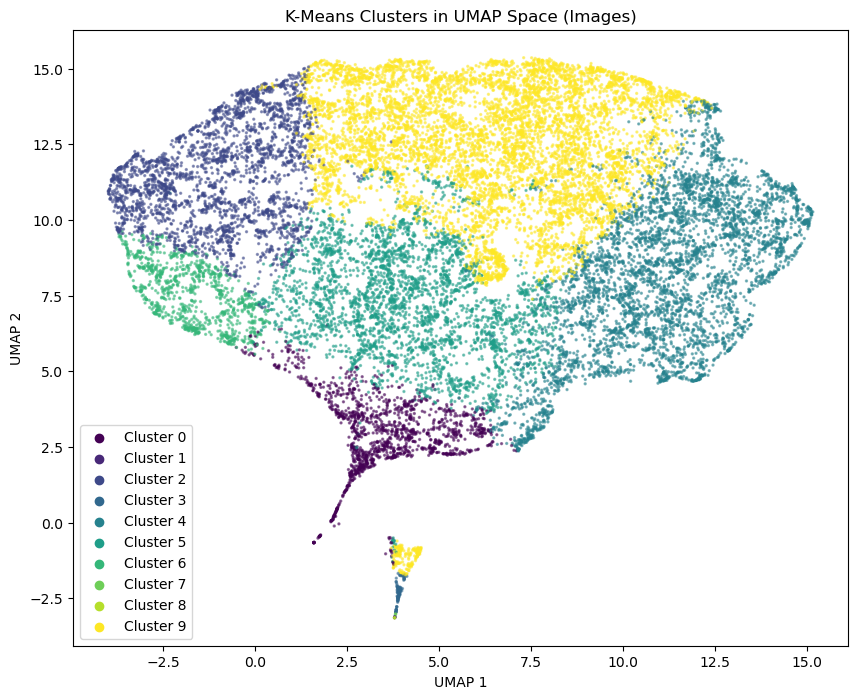

0.23721108

In [ ]:
# %% Cluster the image embeddings using KMeans

num_clusters = 10
kmeans = KMeans(n_clusters=num_clusters, random_state=25101999)
kmeans_clusters_im = kmeans.fit_predict(provabgs["image_embedding"])

# # Add the cluster labels to table
provabgs["kmeans_clusters_im"] = kmeans_clusters_im

# Create the scatter plot
plt.figure(figsize=(10, 8))
scatter = plt.scatter(
    emb_map_im[:, 0],
    emb_map_im[:, 1],
    c=provabgs["kmeans_clusters_im"],
    cmap="viridis",
    s=2,
    alpha=0.5,
)


unique_labels = np.unique(kmeans_clusters_im)
unique_colors = [scatter.cmap(scat) for scat in scatter.norm(unique_labels)]
for i, color in zip(unique_labels, unique_colors):
    plt.scatter([], [], color=color, label=f"Cluster {i}")

plt.legend()
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("K-Means Clusters in UMAP Space (Images)")
plt.show()

# Get the silhouette score for the clustering
silhouette_score(provabgs["image_embedding"], kmeans_clusters_im)

In [ ]:
# %% For spectra clustering

# Get the unique cluster labels and their counts
unique_clusters, counts = np.unique(provabgs["kmeans_cluster_sp"], return_counts=True)

for cluster, count in zip(unique_clusters, counts):
    print(f"Spectrum Cluster {cluster}: {count} entries")

unique_clusters, counts = np.unique(provabgs["kmeans_clusters_im"], return_counts=True)

for cluster, count in zip(unique_clusters, counts):
    print(f"Image Cluster {cluster}: {count} entries")

Spectrum Cluster 0: 509 entries
Spectrum Cluster 1: 3459 entries
Spectrum Cluster 2: 3426 entries
Spectrum Cluster 3: 2255 entries
Spectrum Cluster 4: 834 entries
Spectrum Cluster 5: 226 entries
Spectrum Cluster 6: 5726 entries
Spectrum Cluster 7: 2156 entries
Spectrum Cluster 8: 705 entries
Spectrum Cluster 9: 1755 entries
Image Cluster 0: 1435 entries
Image Cluster 1: 8 entries
Image Cluster 2: 2812 entries
Image Cluster 3: 99 entries
Image Cluster 4: 4767 entries
Image Cluster 5: 3347 entries
Image Cluster 6: 987 entries
Image Cluster 7: 4 entries
Image Cluster 8: 5 entries
Image Cluster 9: 7587 entries


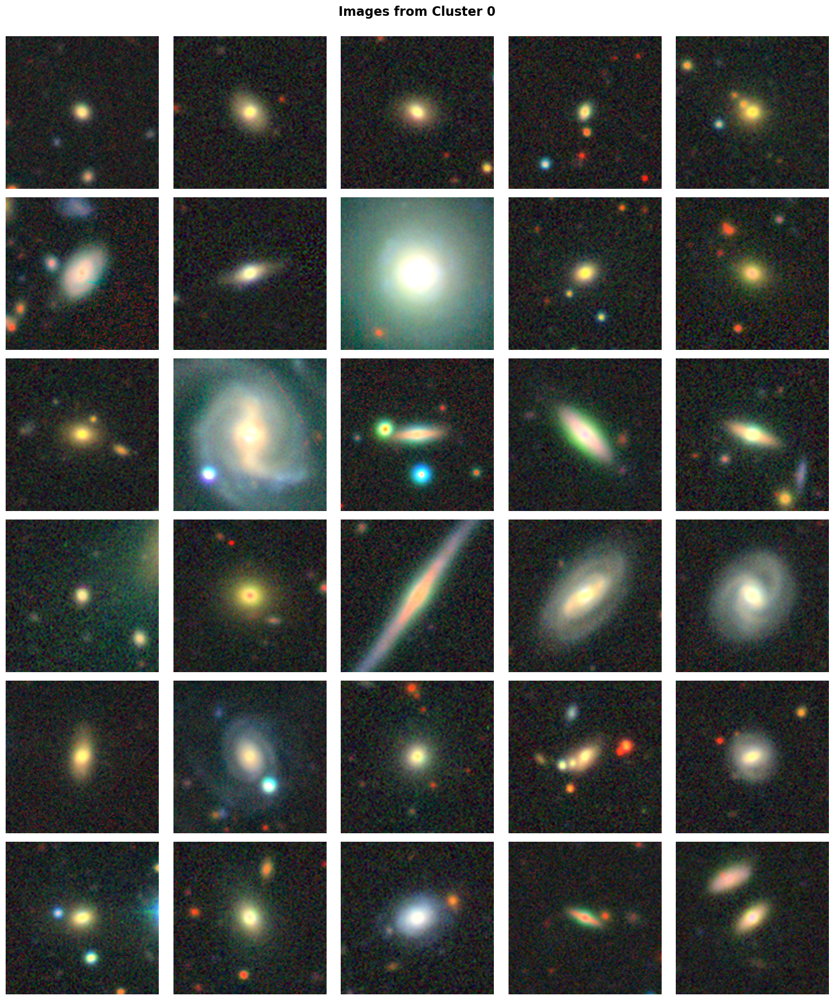

In [ ]:
# %%

# Parameters
cluster_number = 0
num_images_to_display = 30  # Set how many images to display
cluster_type = "kmeans_clusters_im"  # Set the cluster type

# Step 1: Filter to get entries in the specified cluster
cluster_indices = np.where(provabgs[cluster_type] == cluster_number)[0]

# Select a subset of indices (you can use random choice here if preferred)
selected_indices = (
    cluster_indices[:num_images_to_display]
    if len(cluster_indices) > num_images_to_display
    else cluster_indices
)

# Extract images using selected indices
cluster_images = provabgs["source_image"][selected_indices]

# Step 2: Determine how many images you want to display and set up the plot accordingly
cols = 5
rows = (len(cluster_images) + cols - 1) // cols

# Step 3: Create a figure and axes for plotting the images
fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(15, 3 * rows))
ax = ax.flatten()

# Step 4: Plot each image
for i, img in enumerate(cluster_images):
    ax[i].imshow(img)
    ax[i].axis("off")

# Turn off axes for any unused subplots
for j in range(i + 1, len(ax)):
    ax[j].axis("off")

fig.suptitle(f"Images from Cluster {cluster_number}", fontsize=16, fontweight="bold")
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.show()

<>:45: SyntaxWarning: invalid escape sequence '\l'
<>:45: SyntaxWarning: invalid escape sequence '\l'
<ipython-input-42-898ce6e76024>:45: SyntaxWarning: invalid escape sequence '\l'
  ax[0].set_xlabel("$\log(M_*/M_\odot)$")


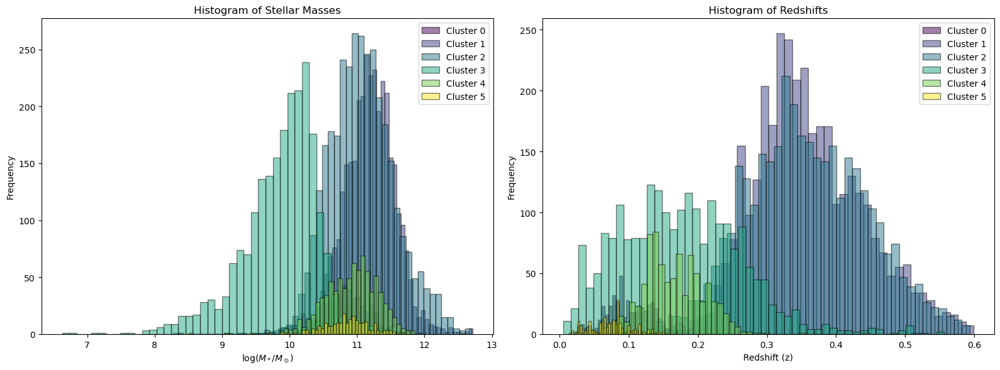

In [ ]:
# %%


def plot_histograms(provabgs, cluster_indices_dict, bin_count=50):
    """
    Plots histograms for the stellar mass and redshift of multiple clusters on the same plots.

    Parameters:
        provabgs (Table): The main data table with all galaxy information.
        cluster_indices_dict (dict): Dictionary where keys are cluster identifiers and values are indices of galaxies in each cluster.
        bin_count (int): Number of bins to use in the histograms.
    """
    # Generate colors for each cluster
    colors = plt.cm.viridis(np.linspace(0, 1, len(cluster_indices_dict)))
    fig, ax = plt.subplots(1, 2, figsize=(16, 6))

    for index, (cluster_label, indices) in enumerate(cluster_indices_dict.items()):
        # Use index to access color
        color = colors[index]

        # Extract the stellar masses and redshifts for the selected indices
        selected_masses = provabgs["PROVABGS_LOGMSTAR_BF"][indices]
        selected_redshifts = provabgs["Z_HP"][indices]

        # Histogram of stellar masses
        ax[0].hist(
            selected_masses,
            bins=bin_count,
            color=color,
            alpha=0.5,
            edgecolor="black",
            label=f"Cluster {cluster_label}",
        )

        # Histogram of redshifts
        ax[1].hist(
            selected_redshifts,
            bins=bin_count,
            color=color,
            alpha=0.5,
            edgecolor="black",
            label=f"Cluster {cluster_label}",
        )

    # Set titles, labels and legends
    ax[0].set_title("Histogram of Stellar Masses")
    ax[0].set_xlabel("$\log(M_*/M_\odot)$")
    ax[0].set_ylabel("Frequency")
    ax[0].legend()

    ax[1].set_title("Histogram of Redshifts")
    ax[1].set_xlabel("Redshift (z)")
    ax[1].set_ylabel("Frequency")
    ax[1].legend()

    plt.tight_layout()
    plt.show()


cluster_numbers = [0, 1, 2, 3, 4, 5]
cluster_indices_dict = {
    num: np.where(provabgs["kmeans_cluster_sp"] == num)[0] for num in cluster_numbers
}

plot_histograms(provabgs, cluster_indices_dict)

<>:49: SyntaxWarning: invalid escape sequence '\l'
<>:49: SyntaxWarning: invalid escape sequence '\l'
<ipython-input-43-e10828b06ff9>:49: SyntaxWarning: invalid escape sequence '\l'
  ax_mass.set_xlabel("$\log(M_*/M_\odot)$")


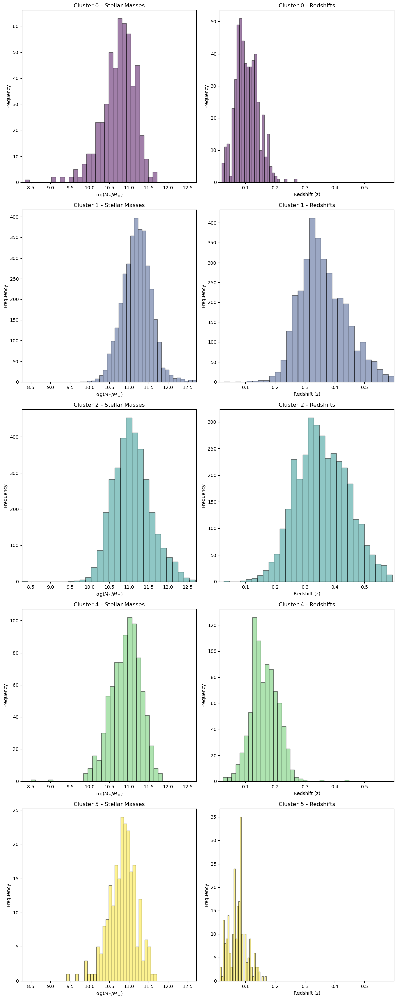

In [ ]:
# %%


def plot_histograms_by_cluster(provabgs, cluster_indices_dict, bin_count=30):
    """
    Plots histograms for the stellar mass and redshift of each cluster on separate subplots with uniform axis limits.

    Parameters:
        provabgs (Table): The main data table with all galaxy information.
        cluster_indices_dict (dict): Dictionary where keys are cluster identifiers and values are indices of galaxies in each cluster.
        bin_count (int): Number of bins to use in the histograms.
    """
    num_clusters = len(cluster_indices_dict)
    fig, axes = plt.subplots(
        num_clusters, 2, figsize=(12, 6 * num_clusters)
    )  # Each cluster gets a row with 2 columns
    colors = plt.cm.viridis(
        np.linspace(0, 1, num_clusters)
    )  # Generate colors for each cluster

    all_masses = []
    all_redshifts = []

    for indices in cluster_indices_dict.values():
        all_masses.append(provabgs["PROVABGS_LOGMSTAR_BF"][indices])
        all_redshifts.append(provabgs["Z_HP"][indices])

    min_mass = np.min(np.hstack(all_masses))
    max_mass = np.max(np.hstack(all_masses))
    min_redshift = np.min(np.hstack(all_redshifts))
    max_redshift = np.max(np.hstack(all_redshifts))

    if num_clusters == 1:  # Handle the case of a single cluster for proper indexing
        axes = np.array([axes])

    for index, ((cluster_label, indices), color) in enumerate(
        zip(cluster_indices_dict.items(), colors)
    ):
        # Extract the stellar masses and redshifts for the selected indices
        selected_masses = provabgs["PROVABGS_LOGMSTAR_BF"][indices]
        selected_redshifts = provabgs["Z_HP"][indices]

        # Plotting the histogram of stellar masses
        ax_mass = axes[index, 0]
        ax_mass.hist(
            selected_masses, bins=bin_count, color=color, alpha=0.5, edgecolor="black"
        )
        ax_mass.set_title(f"Cluster {cluster_label} - Stellar Masses")
        ax_mass.set_xlabel("$\log(M_*/M_\odot)$")
        ax_mass.set_ylabel("Frequency")
        ax_mass.set_xlim(min_mass, max_mass)

        # Plotting the histogram of redshifts
        ax_z = axes[index, 1]
        ax_z.hist(
            selected_redshifts,
            bins=bin_count,
            color=color,
            alpha=0.5,
            edgecolor="black",
        )
        ax_z.set_title(f"Cluster {cluster_label} - Redshifts")
        ax_z.set_xlabel("Redshift (z)")
        ax_z.set_ylabel("Frequency")
        ax_z.set_xlim(min_redshift, max_redshift)

    plt.tight_layout()
    plt.show()


cluster_numbers = [0, 1, 2, 4, 5]
cluster_indices_dict = {
    num: np.where(provabgs["kmeans_cluster_sp"] == num)[0] for num in cluster_numbers
}

plot_histograms_by_cluster(provabgs, cluster_indices_dict)

<>:30: SyntaxWarning: invalid escape sequence '\l'
<>:30: SyntaxWarning: invalid escape sequence '\l'
<ipython-input-45-7a661baea9c5>:30: SyntaxWarning: invalid escape sequence '\l'
  axes[0].set_ylabel("$\log(M_*/M_\odot)$")


boxplot by cluster for spectrum embeddings


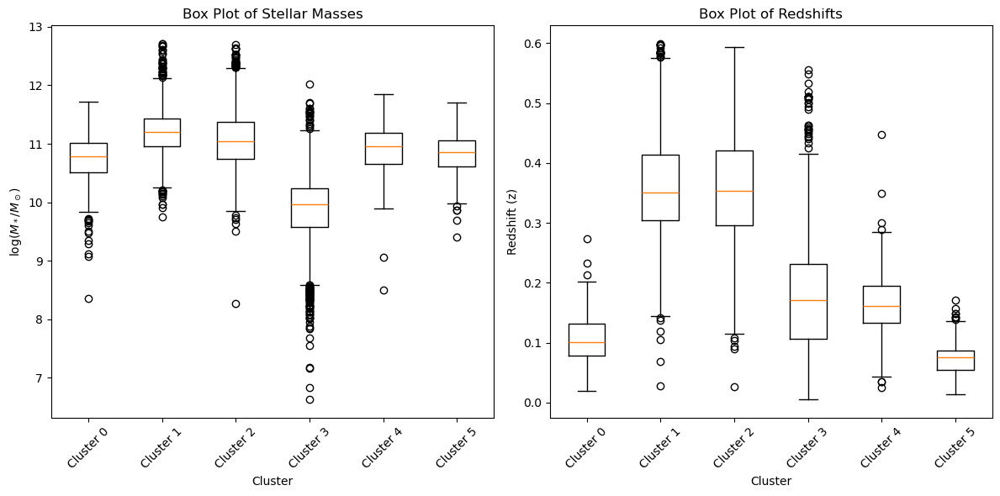

In [ ]:
# %%


def plot_boxplots_by_cluster(provabgs, cluster_indices_dict):
    """
    Plots box plots for the stellar mass and redshift of each cluster.

    Parameters:
        provabgs (Table): The main data table with all galaxy information.
        cluster_indices_dict (dict): Dictionary where keys are cluster identifiers and values are indices of galaxies in each cluster.
    """
    num_clusters = len(cluster_indices_dict)
    fig, axes = plt.subplots(
        1, 2, figsize=(12, 6)
    )  # One row with 2 columns for mass and redshift

    # Prepare data for box plots
    mass_data = [
        provabgs["PROVABGS_LOGMSTAR_BF"][indices]
        for indices in cluster_indices_dict.values()
    ]
    redshift_data = [
        provabgs["Z_HP"][indices] for indices in cluster_indices_dict.values()
    ]

    # Box plot for stellar masses
    axes[0].boxplot(mass_data)
    axes[0].set_title("Box Plot of Stellar Masses")
    axes[0].set_xlabel("Cluster")
    axes[0].set_ylabel("$\log(M_*/M_\odot)$")
    axes[0].set_xticklabels(
        [f"Cluster {k}" for k in cluster_indices_dict.keys()], rotation=45
    )

    # Box plot for redshifts
    axes[1].boxplot(redshift_data)
    axes[1].set_title("Box Plot of Redshifts")
    axes[1].set_xlabel("Cluster")
    axes[1].set_ylabel("Redshift (z)")
    axes[1].set_xticklabels(
        [f"Cluster {k}" for k in cluster_indices_dict.keys()], rotation=45
    )

    plt.tight_layout()
    plt.show()


cluster_numbers = [0, 1, 2, 3, 4, 5]
cluster_indices_dict = {
    num: np.where(provabgs["kmeans_cluster_sp"] == num)[0] for num in cluster_numbers
}

print("boxplot by cluster for spectrum embeddings")
plot_boxplots_by_cluster(provabgs, cluster_indices_dict)